<a href="https://colab.research.google.com/github/jmestanza/computer-vision-2/blob/main/tp_vpc2_yolo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Trabajo práctico integrador de Visión por Computadora 2
Autor: Joaquín Mestanza

N° SIU: a1726

## Problema a resolver

Detección de vehículos con imágenes en plano cenital

## Contexto y restricciones

Las imágenes son tomadas por un drone desde un plano cenital.

Las imágenes son RGB y son de alta resolución (3024x4032 pixeles, height x width).

No siempre hay vehículos ni personas en las instalaciones, de hecho es algo poco frecuente.

## Datasets candidatos

- [Dataset 1] https://universe.roboflow.com/wictronix-ubfrb/atlanz_wx-wthzi

- [Dataset 2] https://universe.roboflow.com/sardar-vallabhbhai-national-institute-if-technology/vehicle-detection-wagr7

- [Dataset 3] https://universe.roboflow.com/roy15957-gmail-com/object-detection-from-drone

Se tuvo en cuenta como primer filtro para la elección de datasets, que tengan al menos 1000 imágenes.
Los 3 dataset incluyen detección de autos, pero el tercero incluye personas también.

## Proceso

Antes de entrenar, debemos tener en cuenta con qué vamos a evaluar.
De ahí salen las siguientes preguntas:

### Entrenamiento
- Vamos a entrenar (train+validation) con
  - Los datasets de roboflow? (3.7k y 1.5k imágenes etiquetadas)

  o
  - Un dataset armado por nosotros? (que implica un etiquetado previo... 1000 imágenes al menos?)
### Testing
- Vamos a evaluar con (test)
  - Los datasets de roboflow? (al menos 100 imágenes)

  y / o
  - Un dataset armado por nosotros? (implica un subset etiquetado, al menos de 100 imágenes)

Algo a tener en cuenta es que cuando probemos con las imágenes en las inspecciones, el terreno es bastante distinto al de las imágenes de roboflow, por lo cual es posible que haya un decaimiento en la performance.
### Métricas a utilizar

La métrica a utilizar es la mAP (mean average precision).

Esta métrica depende de:
- La confianza p de que existe un objeto sea mayor a cierto umbral (> 80%, por ejemplo).
- Que la clase predicha sea la correcta
- Que la IoU del bounding box predicho y el ground truth sea mayor a un umbral predicho (> 50%, por ejemplo).

Hay que tener en consideración que al modificar los valores umbrales de IoU y confianza, cambia nuestra definición de TP (True Positive), FN (False negative), FP (False positive) y TN (True Negative), dando posibles mejores resultados de los que realmente presenta nuestro modelo.


## Utilidades

Query para obtener las imágenes en plano cenital:
```sql
SELECT
	*
FROM
	IMAGE
WHERE
	"missionId" = 'mission_uuid'
	AND (DATA -> 'metadata' -> 'gimbal' ->> 'pitch')::NUMERIC > -(90+10) -- (-90) grados +/- 10
	AND (DATA -> 'metadata' -> 'gimbal' ->> 'pitch')::NUMERIC < -(90-10)
ORDER BY
	CREATED_AT DESC
LIMIT
	100;
```

In [1]:
# !pip install torch torchvision torchaudio
# !pip install 'git+https://github.com/facebookresearch/detectron2.git'
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.3/981.3 kB 49.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 107.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 82.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

Generamos un token para poder subir la info de las runs a Github.

In [2]:
import os
from getpass import getpass
if not os.path.exists('github_pat.txt'):
  github_pat = getpass()
  with open('github_pat.txt', 'w+') as f:
    f.write(github_pat)
else:
  with open('github_pat.txt', 'r') as f:
    github_pat = f.read()

··········


## Descarga de dataset

In [3]:
import os
if not os.path.exists('dataset'):
  !curl -L "https://universe.roboflow.com/ds/y4FMyXSGTl?key=yjkKKPXbbC" > roboflow.zip; echo "Unzipping..."; mkdir dataset; unzip -q roboflow.zip -d dataset; rm roboflow.zip; echo "Completed successfully."

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2352      0 --:--:-- --:--:-- --:--:--  2358
100  428M  100  428M    0     0  16.0M      0  0:00:26  0:00:26 --:--:-- 17.7M
Unzipping...
Completed successfully.


##  Lectura de dataset annotations (formato COCO)

In [4]:
!pip install pycocotools

In [5]:
from pycocotools.coco import COCO
import json

In [6]:
dataset_path = "dataset"
train_path = os.path.join(dataset_path, "train")
val_path = os.path.join(dataset_path, "valid")

train_annotation_file = os.path.join(train_path, "_annotations.coco.json")
val_annotation_file = os.path.join(val_path, "_annotations.coco.json")

# Load COCO annotations
train_coco = COCO(train_annotation_file)
val_coco = COCO(val_annotation_file)

loading annotations into memory...
Done (t=0.30s)
creating index...
index created!
loading annotations into memory...
Done (t=0.04s)
creating index...
index created!


In [7]:
import pandas as pd
import json

def explore(coco):
    # Get all category names
    category_ids = coco.getCatIds()
    categories = coco.loadCats(category_ids)
    print("Categories:", json.dumps(categories, indent=4))
    category_id_to_name = {cat['id']: cat['name'] for cat in categories}
    category_names = [cat['name'] for cat in categories]
    print("Category names:", category_names)

    # Get all image IDs
    image_ids = coco.getImgIds()
    print("Number of images:", len(image_ids))

    # Get annotations
    anns = coco.loadAnns(coco.getAnnIds(imgIds=image_ids))
    annotation_df = pd.DataFrame(anns)
    print("Annotations DataFrame head:\n", annotation_df.head())

    # Unique category IDs
    unique_ids = set(annotation_df["category_id"].values)
    print("Unique category IDs in annotations:", unique_ids)

    # Category distribution
    print("\n🔍 Category distribution:")
    counts = annotation_df["category_id"].value_counts().sort_index()
    for cat_id, count in counts.items():
        cat_name = category_id_to_name.get(cat_id, "Unknown")
        print(f"  {cat_name} (ID {cat_id}): {count} instances")

    return annotation_df


explore(train_coco)

Categories: [
    {
        "id": 0,
        "name": "People-cars",
        "supercategory": "none"
    },
    {
        "id": 1,
        "name": "bu5",
        "supercategory": "People-cars"
    },
    {
        "id": 2,
        "name": "c4r",
        "supercategory": "People-cars"
    },
    {
        "id": 3,
        "name": "consV3h",
        "supercategory": "People-cars"
    },
    {
        "id": 4,
        "name": "motorbik3",
        "supercategory": "People-cars"
    },
    {
        "id": 5,
        "name": "p3rson",
        "supercategory": "People-cars"
    },
    {
        "id": 6,
        "name": "tr2ck",
        "supercategory": "People-cars"
    },
    {
        "id": 7,
        "name": "tr4ck",
        "supercategory": "People-cars"
    },
    {
        "id": 8,
        "name": "v3hicle",
        "supercategory": "People-cars"
    },
    {
        "id": 9,
        "name": "vai",
        "supercategory": "People-cars"
    },
    {
        "id": 10,
        "name": "vai

,id,image_id,category_id,bbox,area,segmentation,iscrowd
0,0,0,2,"[83, 65, 16.5, 48.5]",800.25,[],0
1,1,0,2,"[184, 125, 25.5, 23]",586.50,[],0
2,2,0,2,"[251, 113, 30, 37.5]",1125.00,[],0
3,3,0,2,"[170, 217, 25.5, 23]",586.50,[],0
4,4,0,2,"[203, 223, 16.5, 20]",330.00,[],0
...,...,...,...,...,...,...,...
81091,81091,5174,2,"[238, 0, 26.5, 45.5]",1205.75,[],0
81092,81092,5174,2,"[135, 194, 35.5, 114]",4047.00,[],0
81093,81093,5174,2,"[217, 457, 30.5, 107.5]",3278.75,[],0
81094,81094,5174,5,"[496, 438, 13, 15.5]",201.50,[],0


No annotations for category 'People-cars'


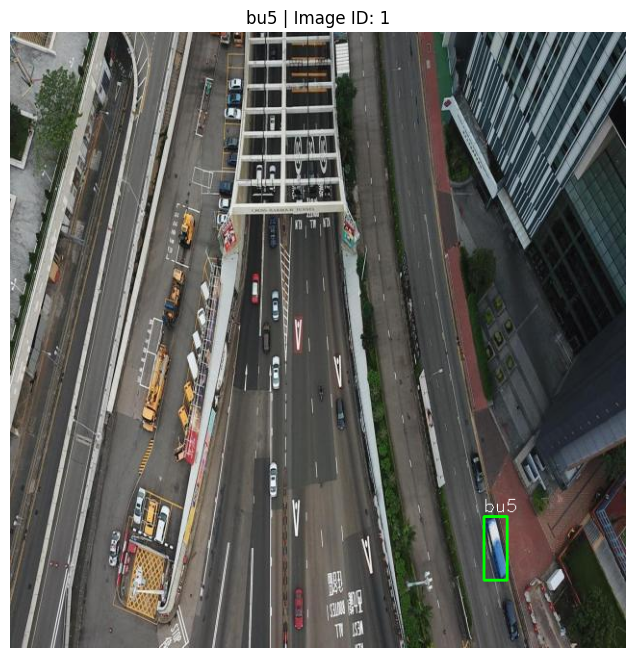

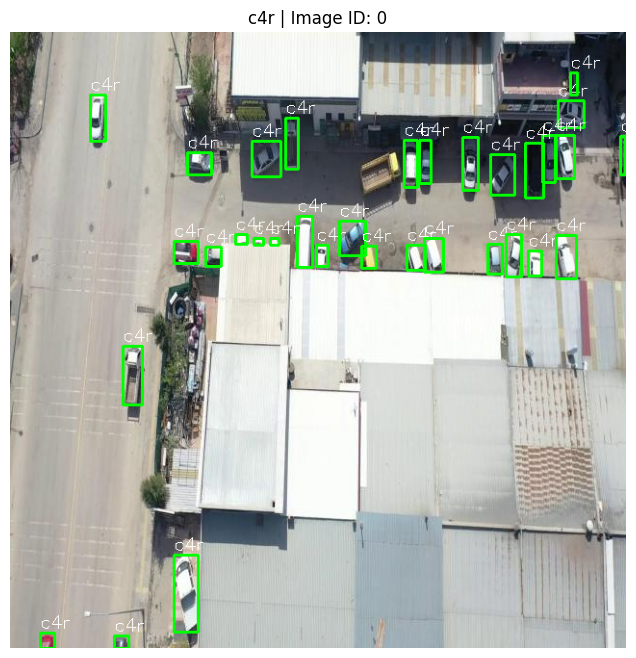

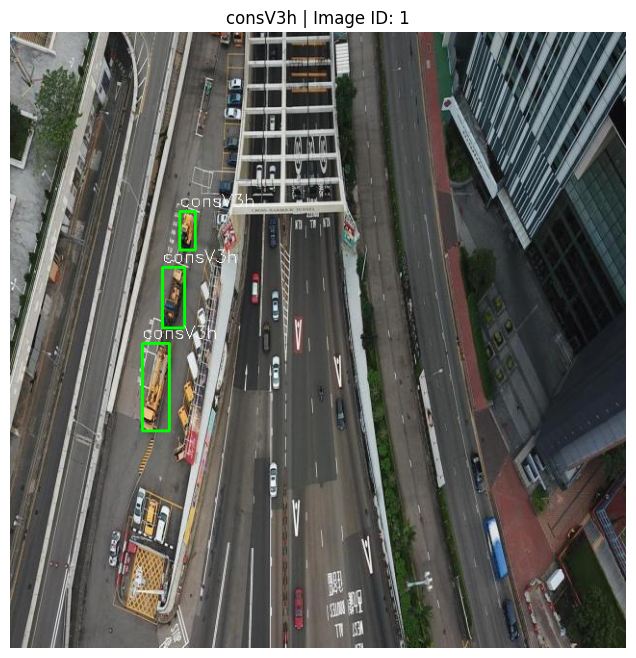

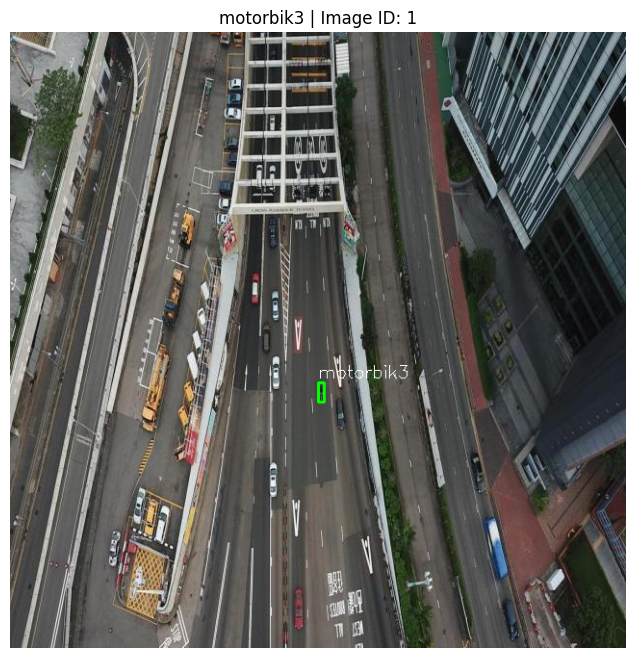

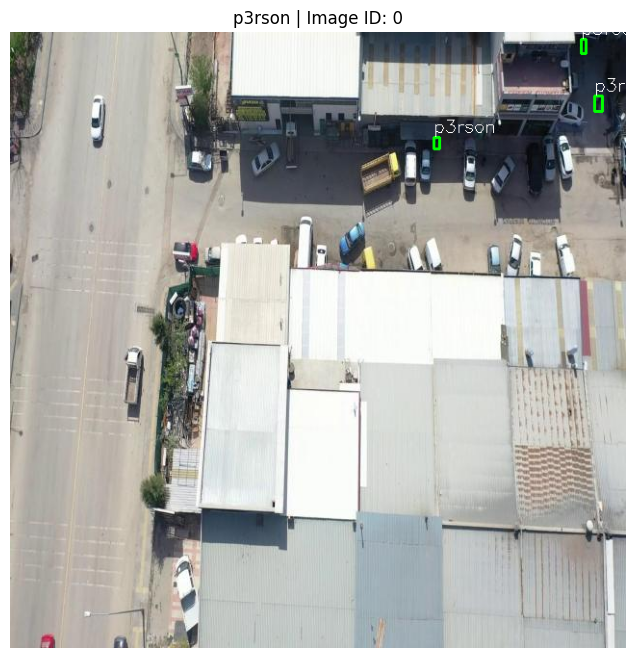

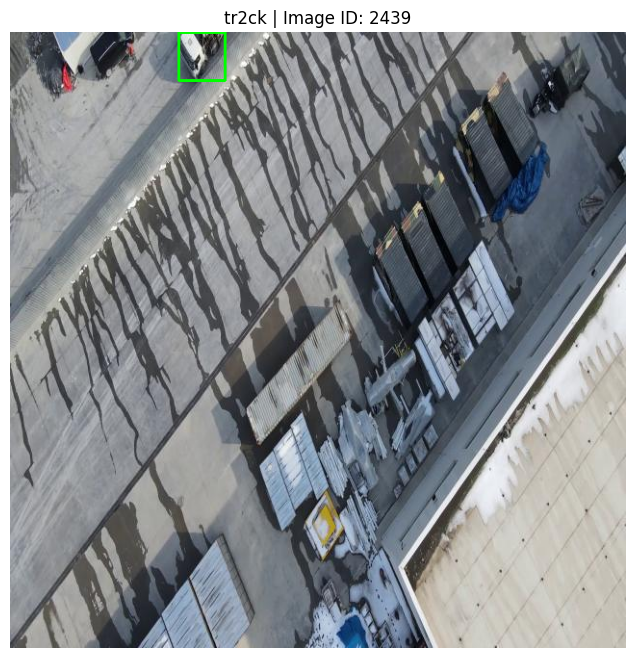

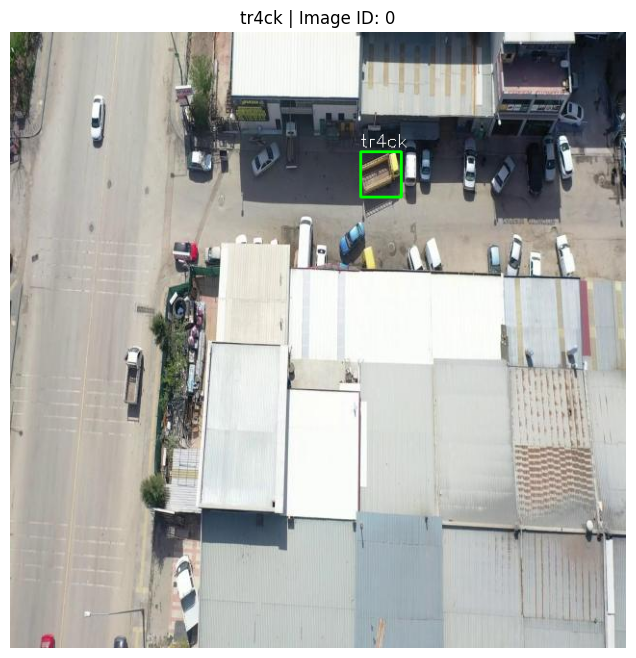

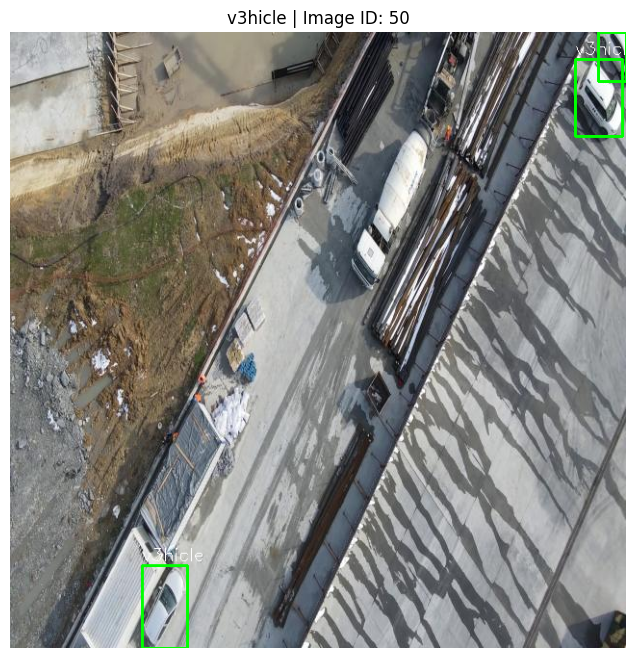

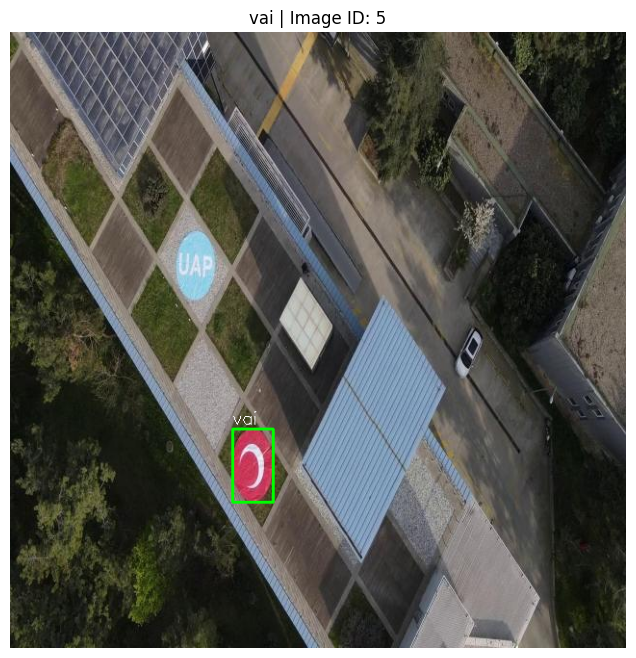

No annotations for category 'vai_false'
No annotations for category 'vai_true'


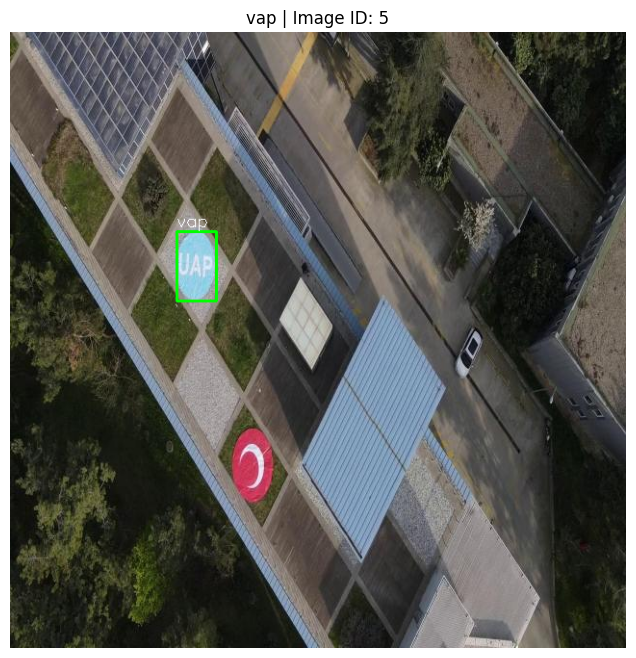

No annotations for category 'vap_false'
No annotations for category 'vap_true'


In [10]:
import matplotlib.pyplot as plt
import cv2
import os
from pycocotools.coco import COCO

def plot_coco_anns_per_category(coco, image_root, n=3):
    category_ids = coco.getCatIds()
    categories = coco.loadCats(category_ids)
    category_id_to_name = {cat['id']: cat['name'] for cat in categories}

    for cat_id in category_ids:
        cat_name = category_id_to_name[cat_id]
        ann_ids = coco.getAnnIds(catIds=[cat_id])
        if not ann_ids:
            print(f"No annotations for category '{cat_name}'")
            continue

        anns = coco.loadAnns(ann_ids)
        seen_img_ids = set()
        images_plotted = 0

        for ann in anns:
            img_id = ann["image_id"]
            if img_id in seen_img_ids:
                continue
            seen_img_ids.add(img_id)

            img_info = coco.loadImgs([img_id])[0]
            img_path = os.path.join(image_root, img_info['file_name'])

            image = cv2.imread(img_path)
            if image is None:
                print(f"⚠️ Could not load image: {img_path}")
                continue

            anns_for_image = coco.loadAnns(coco.getAnnIds(imgIds=[img_id], catIds=[cat_id]))

            # Draw annotations
            for a in anns_for_image:
                x, y, w, h = map(int, a["bbox"])
                cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
                cv2.putText(image, cat_name, (x, y - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 1)

            # Convert BGR to RGB for matplotlib
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            plt.figure(figsize=(8, 8))
            plt.imshow(image_rgb)
            plt.axis("off")
            plt.title(f"{cat_name} | Image ID: {img_id}")
            plt.show()

            images_plotted += 1
            if images_plotted >= n:
                break

# change n for debugging, but we can't save it in github if many images are loaded
plot_coco_anns_per_category(train_coco, train_path, n=1)

## Transformar el dataset a sólo detección de vehiculos o personas

Todas las categorias son:
```
[
  'bu5', 'c4r', 'consV3h', 'motorbik3', 'p3rson', 'tr2ck', 'tr4ck', 'v3hicle',
  'vai', 'vai_false', 'vai_true', 'vap', 'vap_false', 'vap_true'
]
```

De las cuales, las categorias
```
'vai', 'vai_false', 'vai_true', 'vap', 'vap_false', 'vap_true'
```
pertenecen a simbolos en los edificios, lo cual no aportan a nuestro problema, por ende los ignoraremos.

Categorias filtradas:

```
  bu5 (ID 1): 849 instances
  c4r (ID 2): 41370 instances
  consV3h (ID 3): 367 instances. (Vehiculos de construccion)
  motorbik3 (ID 4): 6768 instances
  p3rson (ID 5): 26979 instances
  tr2ck (ID 6): 1 instances
  tr4ck (ID 7): 3095 instances
  v3hicle (ID 8): 734 instances  
```

In [11]:
from pycocotools.coco import COCO
import json


def filter_annotations(coco, output_path):
  # Category name mapping (correcting misspellings)
  vehicle_keywords = {"bu5", "c4r", "consV3h" ,"motorbik3", "tr2ck", "tr4ck", "v3hicle"}
  person_keywords = {"p3rson"}

  # Identify category IDs
  category_mapping = {cat["id"]: cat["name"] for cat in coco.loadCats(coco.getCatIds())}
  print(category_mapping)
  selected_category_ids = {id for id, name in category_mapping.items() if name in vehicle_keywords or name in person_keywords}
  print(selected_category_ids)

  # Standardized category IDs
  category_id_map = {id: 2 if name in vehicle_keywords else 1 for id, name in category_mapping.items() if id in selected_category_ids}

  print(f"Selected Category IDs: {category_id_map}")

  # Filter images and annotations
  filtered_annotations = []
  filtered_images = set()

  for ann in coco.dataset["annotations"]:
      if ann["category_id"] in category_id_map:
          new_ann = {**ann, "category_id": category_id_map[ann["category_id"]]}
          filtered_annotations.append(new_ann)
          filtered_images.add(ann["image_id"])


  # Keep only images that have valid annotations
  filtered_images = [img for img in coco.dataset["images"] if img["id"] in filtered_images]

  new_categories = [{"id": 1, "name": "person"}, {"id": 2, "name": "vehicle"}]

  for old_id, new_id in category_id_map.items():
    new_name = [cat_dict["name"] for cat_dict in new_categories if cat_dict["id"] == new_id][0]
    print(f"{category_mapping[old_id]} -> {new_name}")

  # Create new COCO dataset
  filtered_coco_data = {
      "images": filtered_images,
      "annotations": filtered_annotations,
      "categories": new_categories
  }

  # Save filtered dataset
  with open(output_path, "w", encoding="utf-8") as f:
      json.dump(filtered_coco_data, f, indent=4)

  print(f"Filtered dataset saved to {output_path}")

train_filtered_annotation_file = os.path.join(train_path, "_annotations_filtered.coco.json")
val_filtered_annotation_file = os.path.join(val_path, "_annotations_filtered.coco.json")

filter_annotations(train_coco, train_filtered_annotation_file)
filter_annotations(val_coco, val_filtered_annotation_file)

{0: 'People-cars', 1: 'bu5', 2: 'c4r', 3: 'consV3h', 4: 'motorbik3', 5: 'p3rson', 6: 'tr2ck', 7: 'tr4ck', 8: 'v3hicle', 9: 'vai', 10: 'vai_false', 11: 'vai_true', 12: 'vap', 13: 'vap_false', 14: 'vap_true'}
{1, 2, 3, 4, 5, 6, 7, 8}
Selected Category IDs: {1: 2, 2: 2, 3: 2, 4: 2, 5: 1, 6: 2, 7: 2, 8: 2}
bu5 -> vehicle
c4r -> vehicle
consV3h -> vehicle
motorbik3 -> vehicle
p3rson -> person
tr2ck -> vehicle
tr4ck -> vehicle
v3hicle -> vehicle
Filtered dataset saved to dataset/train/_annotations_filtered.coco.json
{0: 'People-cars', 1: 'bu5', 2: 'c4r', 3: 'consV3h', 4: 'motorbik3', 5: 'p3rson', 6: 'tr2ck', 7: 'tr4ck', 8: 'v3hicle', 9: 'vai', 10: 'vai_false', 11: 'vai_true', 12: 'vap', 13: 'vap_false', 14: 'vap_true'}
{1, 2, 3, 4, 5, 6, 7, 8}
Selected Category IDs: {1: 2, 2: 2, 3: 2, 4: 2, 5: 1, 6: 2, 7: 2, 8: 2}
bu5 -> vehicle
c4r -> vehicle
consV3h -> vehicle
motorbik3 -> vehicle
p3rson -> person
tr2ck -> vehicle
tr4ck -> vehicle
v3hicle -> vehicle
Filtered dataset saved to dataset/valid/

In [12]:
explore(COCO(train_filtered_annotation_file))

loading annotations into memory...
Done (t=0.68s)
creating index...
index created!
Categories: [
    {
        "id": 1,
        "name": "person"
    },
    {
        "id": 2,
        "name": "vehicle"
    }
]
Category names: ['person', 'vehicle']
Number of images: 5132
Annotations DataFrame head:
    id  image_id  category_id                  bbox     area segmentation  \
0   0         0            2  [83, 65, 16.5, 48.5]   800.25           []   
1   1         0            2  [184, 125, 25.5, 23]   586.50           []   
2   2         0            2  [251, 113, 30, 37.5]  1125.00           []   
3   3         0            2  [170, 217, 25.5, 23]   586.50           []   
4   4         0            2  [203, 223, 16.5, 20]   330.00           []   

   iscrowd  
0        0  
1        0  
2        0  
3        0  
4        0  
Unique category IDs in annotations: {np.int64(1), np.int64(2)}

🔍 Category distribution:
  person (ID 1): 26979 instances
  vehicle (ID 2): 53184 instances


,id,image_id,category_id,bbox,area,segmentation,iscrowd
0,0,0,2,"[83, 65, 16.5, 48.5]",800.25,[],0
1,1,0,2,"[184, 125, 25.5, 23]",586.50,[],0
2,2,0,2,"[251, 113, 30, 37.5]",1125.00,[],0
3,3,0,2,"[170, 217, 25.5, 23]",586.50,[],0
4,4,0,2,"[203, 223, 16.5, 20]",330.00,[],0
...,...,...,...,...,...,...,...
80158,81091,5174,2,"[238, 0, 26.5, 45.5]",1205.75,[],0
80159,81092,5174,2,"[135, 194, 35.5, 114]",4047.00,[],0
80160,81093,5174,2,"[217, 457, 30.5, 107.5]",3278.75,[],0
80161,81094,5174,1,"[496, 438, 13, 15.5]",201.50,[],0


loading annotations into memory...
Done (t=0.58s)
creating index...
index created!


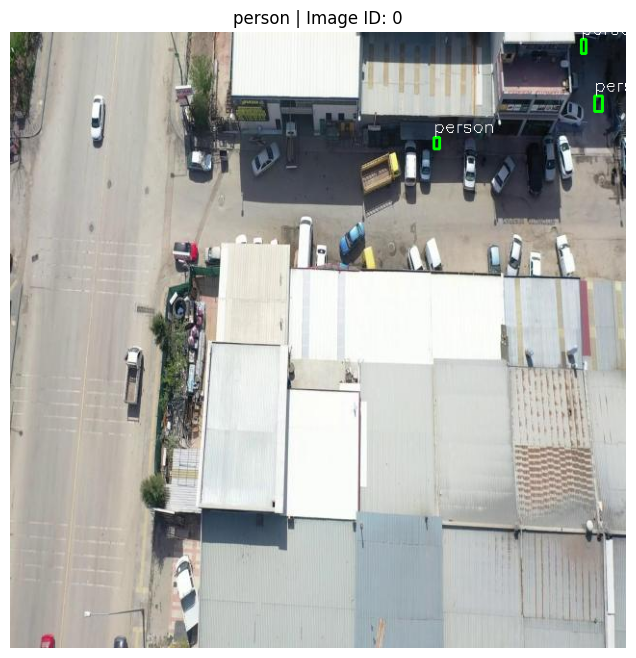

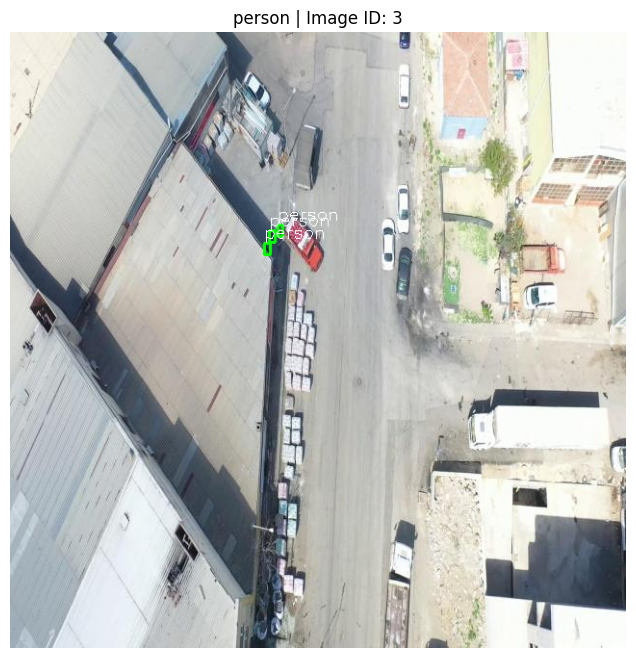

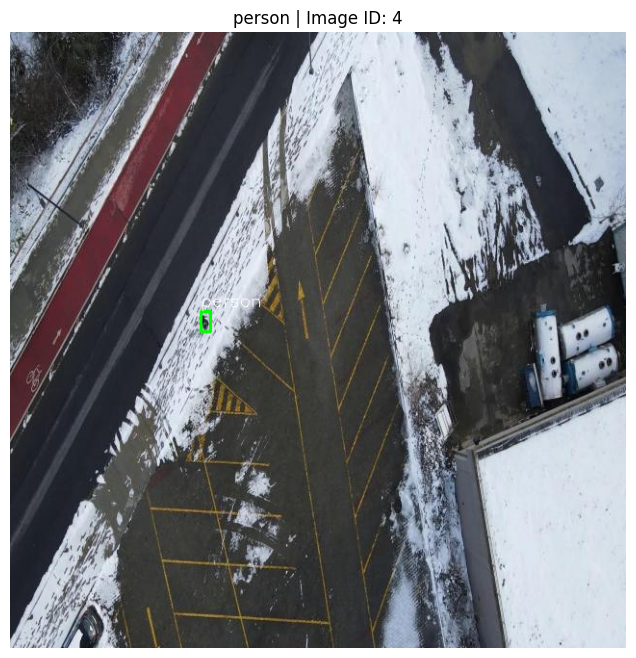

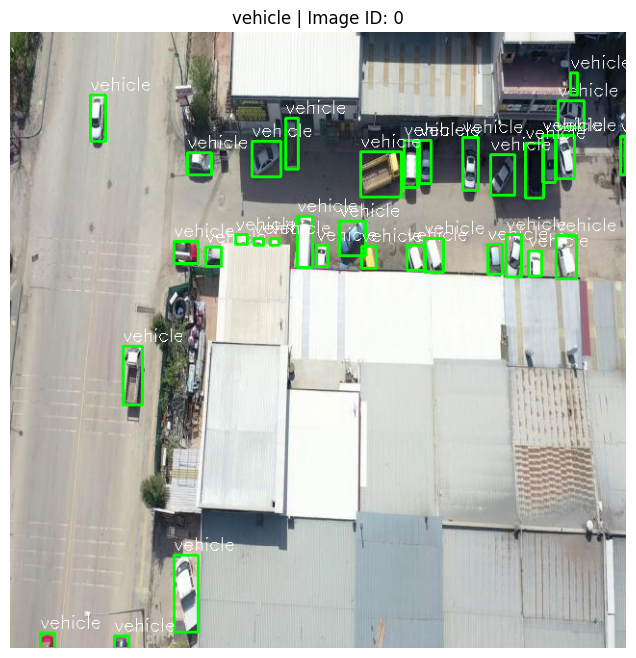

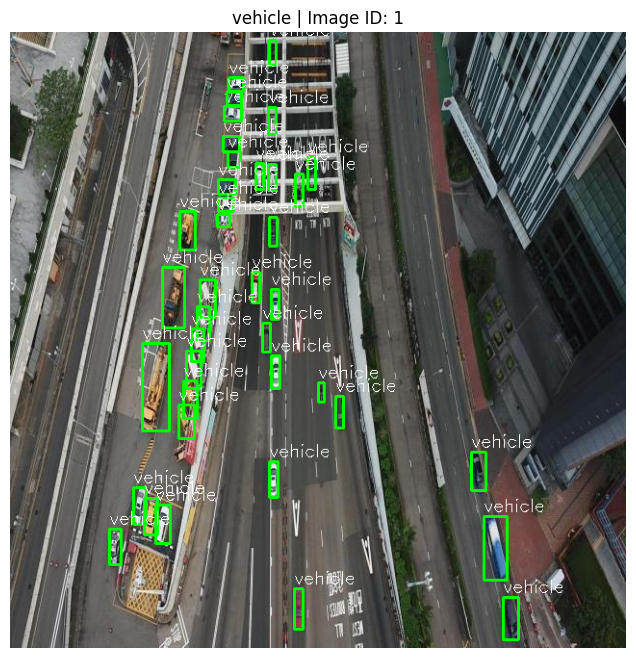

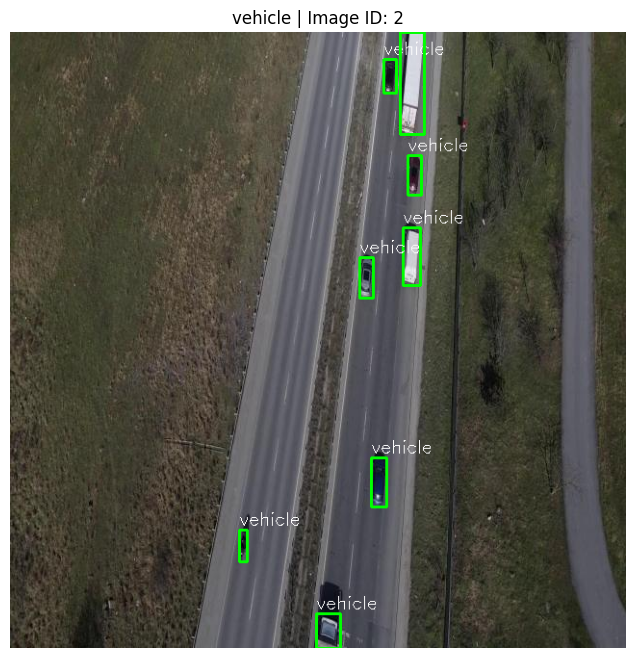

In [13]:
plot_coco_anns_per_category(COCO(train_filtered_annotation_file), train_path, n=3)

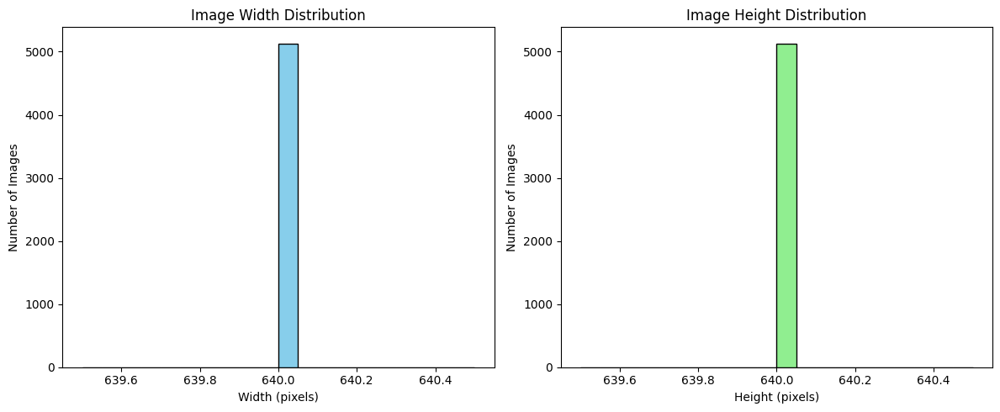

In [14]:
import json
import matplotlib.pyplot as plt

# Load the annotation JSON file
with open(train_filtered_annotation_file, 'r') as f:
    data = json.load(f)

# Extract width and height of all images
widths = [img['width'] for img in data['images']]
heights = [img['height'] for img in data['images']]

# Plot histograms
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(widths, bins=20, color='skyblue', edgecolor='black')
plt.title('Image Width Distribution')
plt.xlabel('Width (pixels)')
plt.ylabel('Number of Images')

plt.subplot(1, 2, 2)
plt.hist(heights, bins=20, color='lightgreen', edgecolor='black')
plt.title('Image Height Distribution')
plt.xlabel('Height (pixels)')
plt.ylabel('Number of Images')

plt.tight_layout()
plt.show()


[33.655177575689535, 66.34482242431046]


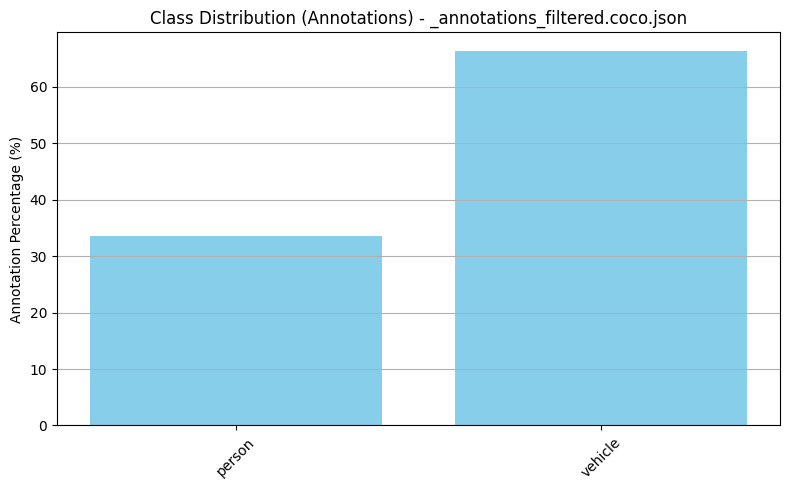

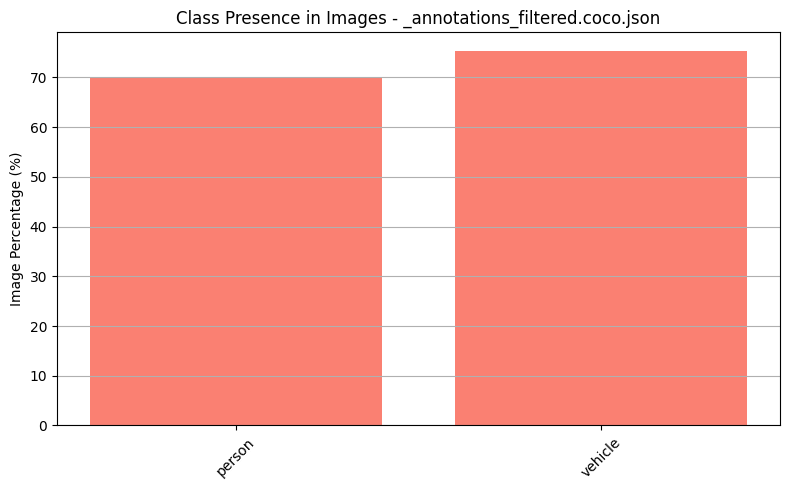

In [15]:
import json
from collections import defaultdict
import matplotlib.pyplot as plt
import os

def analyze_and_plot_coco_annotations(annotation_path, class_mapping=None):
    """
    Loads a COCO annotation file, computes class distribution as percentages, and plots them in two separate bar charts.

    Args:
        annotation_path (str): Path to the COCO-format JSON file.
        class_mapping (dict): Optional. Maps category_id to class name, e.g., {1: 'person', 2: 'vehicle'}
    """
    # Load the JSON
    with open(annotation_path, "r") as f:
        data = json.load(f)

    # Build category ID to name mapping if not provided
    if class_mapping is None:
        class_mapping = {cat["id"]: cat["name"] for cat in data["categories"]}

    # Initialize counters
    annotation_counts = defaultdict(int)
    image_class_map = defaultdict(set)

    for ann in data["annotations"]:
        cat_id = ann["category_id"]
        annotation_counts[cat_id] += 1
        image_class_map[ann["image_id"]].add(cat_id)

    image_counts = defaultdict(int)
    for class_ids in image_class_map.values():
        for cid in class_ids:
            image_counts[cid] += 1

    # Prepare data for plotting
    class_ids_sorted = sorted(class_mapping.keys())
    class_labels = [class_mapping[cid] for cid in class_ids_sorted]

    total_anns = sum(annotation_counts[cid] for cid in class_ids_sorted)
    total_imgs = len(image_class_map)

    ann_percentages = [
        100 * annotation_counts[cid] / total_anns if total_anns > 0 else 0
        for cid in class_ids_sorted
    ]
    img_percentages = [
        100 * image_counts[cid] / total_imgs if total_imgs > 0 else 0
        for cid in class_ids_sorted
    ]
    print(ann_percentages)

    # Plot 1: Annotation percentages
    plt.figure(figsize=(8, 5))
    plt.bar(class_labels, ann_percentages, color="skyblue")
    plt.ylabel("Annotation Percentage (%)")
    plt.title(f"Class Distribution (Annotations) - {os.path.basename(annotation_path)}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.grid(axis='y')
    plt.show()

    # Plot 2: Image percentages
    plt.figure(figsize=(8, 5))
    plt.bar(class_labels, img_percentages, color="salmon")
    plt.ylabel("Image Percentage (%)")
    plt.title(f"Class Presence in Images - {os.path.basename(annotation_path)}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.grid(axis='y')
    plt.show()


analyze_and_plot_coco_annotations(train_filtered_annotation_file)

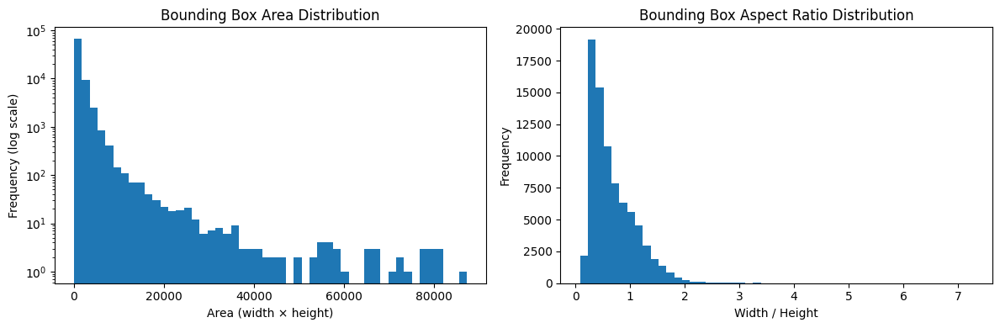

Total boxes: 80163
Small (<32²):  52963 (66.1%)
Medium (<96²): 26609 (33.2%)
Large (≥96²):  591 (0.7%)


In [16]:
import json
import matplotlib.pyplot as plt

def analyze_bbox_sizes(annotation_path):
    with open(annotation_path, 'r') as f:
        coco = json.load(f)

    areas = []
    aspect_ratios = []
    small, medium, large = 0, 0, 0

    for ann in coco["annotations"]:
        x, y, w, h = ann["bbox"]
        area = w * h
        if h > 0:
            aspect_ratio = w / h
            aspect_ratios.append(aspect_ratio)
        areas.append(area)

        # COCO size thresholds
        if area < 32**2:
            small += 1
        elif area < 96**2:
            medium += 1
        else:
            large += 1

    # Area distribution
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.hist(areas, bins=50, log=True)
    plt.title("Bounding Box Area Distribution")
    plt.xlabel("Area (width × height)")
    plt.ylabel("Frequency (log scale)")

    # Aspect ratio distribution
    plt.subplot(1, 2, 2)
    plt.hist(aspect_ratios, bins=50)
    plt.title("Bounding Box Aspect Ratio Distribution")
    plt.xlabel("Width / Height")
    plt.ylabel("Frequency")

    plt.tight_layout()
    plt.show()

    # Print size category breakdown
    total = small + medium + large
    print(f"Total boxes: {total}")
    print(f"Small (<32²):  {small} ({small/total:.1%})")
    print(f"Medium (<96²): {medium} ({medium/total:.1%})")
    print(f"Large (≥96²):  {large} ({large/total:.1%})")

analyze_bbox_sizes(train_filtered_annotation_file)


In [17]:
[el for el in os.listdir(train_path) if not el.endswith(".jpg")]

['_annotations_filtered.coco.json', '_annotations.coco.json']

In [18]:
import json
from collections import defaultdict

# Load the filtered COCO annotations
with open("dataset/train/_annotations_filtered.coco.json", "r") as f:
    coco = json.load(f)

# Image IDs grouped by category
category_to_image_ids = defaultdict(set)

for ann in coco["annotations"]:
    category_id = ann["category_id"]
    image_id = ann["image_id"]
    category_to_image_ids[category_id].add(image_id)

# Count how many unique images have person and vehicle detections
person_images = category_to_image_ids[1]
vehicle_images = category_to_image_ids[2]

# Print stats
print(f"Images with 'person': {len(person_images)}")
print(f"Images with 'vehicle': {len(vehicle_images)}")
print(f"Images with both: {len(person_images & vehicle_images)}")
print(f"Images with either: {len(person_images | vehicle_images)}")


Images with 'person': 3592
Images with 'vehicle': 3865
Images with both: 2325
Images with either: 5132


In [19]:
import json

with open(train_filtered_annotation_file, "r") as f:
    data = json.load(f)

print("Number of images:", len(data.get("images", [])))
print("Number of annotations:", len(data.get("annotations", [])))


Number of images: 5132
Number of annotations: 80163


## Val subset (Debugging)

```python
# Load the full validation dataset
val_dataset_dicts = DatasetCatalog.get(val_dataset_name)

# Create a subset with the first 250 images
val_subset_dicts = val_dataset_dicts[:250]

# Optional: Check how many are in the subset
print(f"Validation subset contains {len(val_subset_dicts)} images.")

val_subset_name = "val_subset_250"

# Unregister if already exists
unregister_dataset(val_subset_name)

# Register subset using a lambda so it's only sliced once
DatasetCatalog.register(val_subset_name, lambda: val_dataset_dicts[:250])
MetadataCatalog.get(val_subset_name).set(thing_classes=metadata.thing_classes)

# Load to verify
subset_loaded = DatasetCatalog.get(val_subset_name)
print(f"Subset registered with {len(subset_loaded)} images.")

```

In [26]:
import os

repo_path = '/content/computer-vision-2'
if not os.path.exists(repo_path):
  print('Repo not downloaded yet.')
  !git clone https://{github_pat}@github.com/jmestanza/computer-vision-2.git
else:
  print('Repo available.')

Repo not downloaded yet.
Cloning into 'computer-vision-2'...
remote: Enumerating objects: 613, done.
remote: Counting objects: 100% (151/151), done.
remote: Compressing objects: 100% (91/91), done.
remote: Total 613 (delta 102), reused 87 (delta 60), pack-reused 462 (from 1)
Receiving objects: 100% (613/613), 702.78 MiB | 16.23 MiB/s, done.
Resolving deltas: 100% (274/274), done.


In [27]:
import datetime
import uuid

if not os.path.exists(f'{repo_path}/runs'):
    os.makedirs(f'{repo_path}/runs')
    print('Directory created.')
else:
    print('Directory already exists.')

run_id = str(uuid.uuid4())
print("run_id: ", run_id)
run_id_folder = f"run_id_{run_id}"

if not os.path.exists(f'{repo_path}/runs/{run_id_folder}'):
    os.makedirs(f'{repo_path}/runs/{run_id_folder}')
    print('Directory created.')
else:
    print('Directory already exists.')

Directory already exists.
run_id:  74e9c08f-4fe1-4ad6-a1f5-7679a5fe7cd5
Directory created.


Deleted /content/dataset/train.cache
Deleted /content/dataset/valid.cache


In [45]:
import os

image_dir = "/content/dataset/train"
label_dir = "/content/dataset/labels/train"

for image_file in os.listdir(image_dir):
    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(label_dir, label_file)
    if not os.path.exists(label_path) or os.path.getsize(label_path) == 0:
        print(f"Missing or empty label for {image_file}")


Missing or empty label for _annotations_filtered.coco.json
Missing or empty label for spatiumvision_03797_jpg.rf.220bf74e612e2c1083cceb8ca55e2136.jpg
Missing or empty label for spatiumvision_03490_jpg.rf.ec8bd4a4d913ace86becb042be182b55.jpg
Missing or empty label for spatiumvision_03802_jpg.rf.00f4b6a65df6c6f7a31ee5d0699cbe73.jpg
Missing or empty label for spatiumvision_02211_jpg.rf.e86fcb5a274f1c76e24951602d8cf616.jpg
Missing or empty label for spatiumvision_02623_jpg.rf.3783bf9d5981161582f31b95a524e544.jpg
Missing or empty label for spatiumvision_02390_jpg.rf.9c45a827be7f723d7e13d041f727479e.jpg
Missing or empty label for spatiumvision_01742_jpg.rf.acaf125718507a3d1afddbde2da41915.jpg
Missing or empty label for spatiumvision_02912_jpg.rf.7e952c2dd49e104a5c488fff81cd7010.jpg
Missing or empty label for spatiumvision_02627_jpg.rf.f13552d07ce220b5fbf57b4bce9a104c.jpg
Missing or empty label for spatiumvision_03478_jpg.rf.b45d2b4ee3e9696b083e76f934c33a17.jpg
Missing or empty label for spat

In [50]:
from ultralytics import YOLO
import os
import json
import os

cache_dir = "/content/dataset"
for cache_file in ["train.cache", "valid.cache"]:
    cache_path = os.path.join(cache_dir, cache_file)
    if os.path.exists(cache_path):
        os.remove(cache_path)
        print(f"Deleted {cache_path}")



import os
import json

import os
import json

def convert_coco_to_yolo(coco_json_path, output_dir, images_dir):
    os.makedirs(output_dir, exist_ok=True)

    with open(coco_json_path, 'r', encoding='utf-8') as f:
        coco = json.load(f)

    print("coco: ", coco)
    # Mapping from image_id to filename and image dimensions
    image_id_to_filename = {img["id"]: img["file_name"] for img in coco["images"]}
    image_id_to_size = {img["id"]: (img["width"], img["height"]) for img in coco["images"]}

    # Creating annotations dictionary grouped by image_id
    annotations_by_image = {}
    for ann in coco["annotations"]:
        img_id = ann["image_id"]
        if img_id not in annotations_by_image:
            annotations_by_image[img_id] = []
        annotations_by_image[img_id].append(ann)

    # Writing the YOLO label files
    for img_id, anns in annotations_by_image.items():
        file_name = os.path.splitext(image_id_to_filename[img_id])[0]  # remove extension
        width, height = image_id_to_size[img_id]

        # Skip images without annotations
        if not anns:
            print(f"Warning: No annotations found for image {file_name}")
            continue

        label_file_path = os.path.join(output_dir, f"{file_name}.txt")

        with open(label_file_path, 'w') as f:
            for ann in anns:
                x, y, w, h = ann["bbox"]
                # Convert to YOLO format (normalized)
                x_center = (x + w / 2) / width
                y_center = (y + h / 2) / height
                w /= width
                h /= height
                category_id = ann["category_id"] - 1  # YOLO format expects 0-based class IDs
                f.write(f"{category_id} {x_center} {y_center} {w} {h}\n")

# Example usage

convert_coco_to_yolo(train_filtered_annotation_file, "dataset/labels/train", train_path)
convert_coco_to_yolo(val_filtered_annotation_file, "dataset/labels/val", val_path)


import yaml


def create_yolo_yaml(save_path, train_img_dir, val_img_dir, class_names):
    data = {
        "train": train_img_dir,
        "val": val_img_dir,
        "nc": len(class_names),
        "names": class_names
    }

    with open(save_path, 'w') as f:
        yaml.dump(data, f)

create_yolo_yaml(
    "custom_data.yaml",
    "/content/dataset/train",
    "/content/dataset/valid",
    ["person", "vehicle"]
)


with open("custom_data.yaml", "r") as f:
  print(f.read())

import os
from collections import defaultdict
import yaml

def count_images_per_category_yolo(labels_dir, class_names_path):
    # Load class names from YAML
    with open(class_names_path, 'r') as f:
        data = yaml.safe_load(f)
        class_names = data['names']

    category_to_images = defaultdict(set)

    # Go through all label files
    for label_file in os.listdir(labels_dir):
        if not label_file.endswith('.txt'):
            continue

        label_path = os.path.join(labels_dir, label_file)
        image_id = os.path.splitext(label_file)[0]

        with open(label_path, 'r') as f:
            for line in f:
                if line.strip() == "":
                    continue
                class_id = int(line.split()[0])
                category_to_images[class_id].add(image_id)

    # Report
    print(f"Dataset labels in: {labels_dir}")
    for class_id, images in category_to_images.items():
        class_name = class_names[class_id] if class_id < len(class_names) else f"Class {class_id}"
        print(f"  {class_name}: {len(images)} images")

# Example usage
train_labels_dir = "/content/dataset/labels/train"
val_labels_dir = "/content/dataset/labels/val"
yaml_path = "/content/custom_data.yaml"

count_images_per_category_yolo(train_labels_dir, yaml_path)
count_images_per_category_yolo(val_labels_dir, yaml_path)




coco:  {'images': [{'id': 0, 'license': 1, 'file_name': 'spatiumvision_01827_jpg.rf.9e8ae249e3975eced036804540c8a637.jpg', 'height': 640, 'width': 640, 'date_captured': '2024-05-23T06:40:45+00:00'}, {'id': 1, 'license': 1, 'file_name': 'spatiumvision_00615_jpg.rf.9f4384f71099bc1c0984e473bf13218d.jpg', 'height': 640, 'width': 640, 'date_captured': '2024-05-23T06:40:45+00:00'}, {'id': 2, 'license': 1, 'file_name': 'spatiumvision_02661_jpg.rf.9eec8980bfd590097e1ccdeb21ed1ed4.jpg', 'height': 640, 'width': 640, 'date_captured': '2024-05-23T06:40:45+00:00'}, {'id': 3, 'license': 1, 'file_name': 'spatiumvision_03004_jpg.rf.9f96bd64a0667cb20599bf5a9733351f.jpg', 'height': 640, 'width': 640, 'date_captured': '2024-05-23T06:40:45+00:00'}, {'id': 4, 'license': 1, 'file_name': 'spatiumvision_04710_jpg.rf.9f918d4c9631d8a3257ae15c36fa4a07.jpg', 'height': 640, 'width': 640, 'date_captured': '2024-05-23T06:40:45+00:00'}, {'id': 5, 'license': 1, 'file_name': 'spatiumvision_01933_jpg.rf.9ea2458374820cde

In [51]:
import os

image_dir = "/content/dataset/train"
label_dir = "/content/dataset/labels/train"

for image_file in os.listdir(image_dir):
    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(label_dir, label_file)
    if not os.path.exists(label_path) or os.path.getsize(label_path) == 0:
        print(f"Missing or empty label for {image_file}")

Missing or empty label for _annotations_filtered.coco.json
Missing or empty label for spatiumvision_03797_jpg.rf.220bf74e612e2c1083cceb8ca55e2136.jpg
Missing or empty label for spatiumvision_03490_jpg.rf.ec8bd4a4d913ace86becb042be182b55.jpg
Missing or empty label for spatiumvision_03802_jpg.rf.00f4b6a65df6c6f7a31ee5d0699cbe73.jpg
Missing or empty label for spatiumvision_02211_jpg.rf.e86fcb5a274f1c76e24951602d8cf616.jpg
Missing or empty label for spatiumvision_02623_jpg.rf.3783bf9d5981161582f31b95a524e544.jpg
Missing or empty label for spatiumvision_02390_jpg.rf.9c45a827be7f723d7e13d041f727479e.jpg
Missing or empty label for spatiumvision_01742_jpg.rf.acaf125718507a3d1afddbde2da41915.jpg
Missing or empty label for spatiumvision_02912_jpg.rf.7e952c2dd49e104a5c488fff81cd7010.jpg
Missing or empty label for spatiumvision_02627_jpg.rf.f13552d07ce220b5fbf57b4bce9a104c.jpg
Missing or empty label for spatiumvision_03478_jpg.rf.b45d2b4ee3e9696b083e76f934c33a17.jpg
Missing or empty label for spat

In [ ]:
# Pick model type: 'yolov8n', 'yolov8s', 'yolov8m', 'yolov8l', 'yolov8x'
model = YOLO('yolov8s.yaml')  # You can also use 'yolov8s.pt' for pretrained weights

# Optional: use pretrained weights
# model = YOLO('yolov8s.pt')

# Start training
model.train(
    data='custom_data.yaml',         # path to your YAML
    epochs=100,                      # or more if needed
    imgsz=640,                       # image size
    batch=16,
    name='yolo_person_vehicle',      # experiment name
    project='./runs',
    device=0,                        # set to 'cpu' or specific GPU ID
    workers=2,
    optimizer='SGD',                 # or 'Adam'
    lr0=0.001,
    warmup_epochs=3,
    cos_lr=True,
    weight_decay=0.0005,
    patience=20,                     # early stopping
    val=True                         # evaluate on val set
)

In [ ]:
# metrics are under output folder
!cp -r output/ {repo_path}/runs/{run_id_folder}
# delete pth as it weights too much (300Mb)
!rm -rf {repo_path}/runs/{run_id_folder}/output/*.pth

with open(f'{repo_path}/runs/{run_id_folder}/cfg-{run_id}.yaml', "w") as f:
    f.write(cfg.dump())

In [ ]:
start_path = os.getcwd()
print(start_path)
os.chdir(repo_path)
print(os.getcwd())
!git config --global user.email "jmestanza@gmail.com"
!git config --global user.name "jmestanza"
!git config pull.rebase false
!git pull
!git add .
# !git commit -m "uploading run {run_id}"
os.system(f'git commit -m "uploading run {run_id}"')
!git push origin main
os.chdir(start_path)

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.transforms import AugInput
import matplotlib.pyplot as plt
import cv2
from detectron2.data import transforms as T
import detectron2.data.detection_utils as utils

augmentations = [
    T.RandomFlip(prob=0.5, horizontal=True, vertical=False),
    T.RandomBrightness(0.8, 1.2),
    T.RandomContrast(0.8, 1.2),
    T.RandomSaturation(0.8, 1.2),
    # You can also add:
    T.RandomRotation(angle=[-10, 10]),
    T.RandomCrop("relative_range", (0.8, 0.8)),
]

dataset_dicts = DatasetCatalog.get(train_dataset_name)
metadata = MetadataCatalog.get(train_dataset_name)
sample = dataset_dicts[0]
image = utils.read_image(sample["file_name"], format="BGR")
auginput = AugInput(image)
transform = T.AugmentationList(augmentations)(auginput)
aug_image = auginput.image

plt.imshow(cv2.cvtColor(aug_image, cv2.COLOR_BGR2RGB))
plt.title("Augmented Image")
plt.axis("off")
plt.show()


In [ ]:
import random
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
import cv2
import os

def predict_n_random_images(n=5):
  # Initialize predictor

  # Point to your trained model
  cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, f"model_final.pth")
  # cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_0024999.pth")

  # Recreate the predictor after setting weights
  predictor = DefaultPredictor(cfg)

  # Get metadata
  metadata = MetadataCatalog.get(val_dataset_name)

  # Shuffle images
  val_images = sorted(os.listdir(val_path))
  random.shuffle(val_images)

  # Show n random predictions
  num_to_show = n
  for i, fname in enumerate(val_images[:num_to_show]):
      image_path = os.path.join(val_path, fname)
      image = cv2.imread(image_path)

      outputs = predictor(image)
      instances = outputs["instances"].to("cpu")

      v = Visualizer(image[:, :, ::-1], metadata=metadata, scale=1.0)
      out = v.draw_instance_predictions(instances)

      plt.figure(figsize=(10, 10))
      plt.imshow(out.get_image())
      plt.title(f"Predictions for: {fname}")
      plt.axis("off")
      plt.show()

predict_n_random_images(5)

## Descargo pesos automáticamente

In [ ]:
print(eval_period)

In [ ]:
weights = [el for el in os.listdir('output') if el.startswith('model') and el.endswith('.pth')]
print(weights)
# download 5 last weights

In [ ]:
from google.colab import files
# save best models
output_dir = cfg.OUTPUT_DIR

best_model_person = f"model_best_person_{run_id}.pth"
best_model_vehicle = f"model_best_vehicle_{run_id}.pth"
files.download(f"{output_dir}/{best_model_person}")
files.download(f"{output_dir}/{best_model_vehicle}")

In [ ]:
# save last
import shutil
new_filename = f"model_final_{run_id}.pth"
shutil.copy(f"{output_dir}/model_final.pth", f"{output_dir}/{new_filename}")
files.download(f"{output_dir}/{new_filename}")

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir output

In [ ]:
%tensorboard --logdir {repo_path}/runs